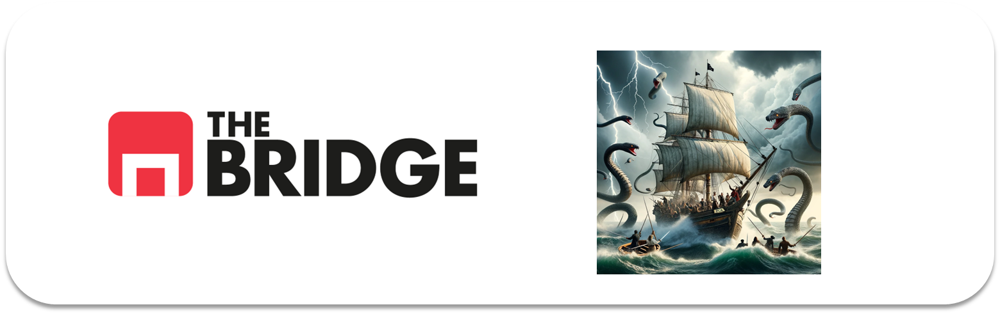

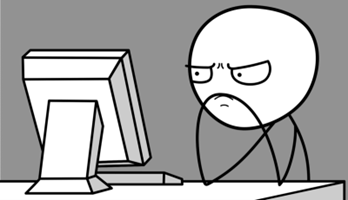

Para ejercitarte y afianzar lo aprendido sobre **Seleccion de Features**, completa los siguientes ejercicios. Recuerda que necesitarás datos que están en el directorio data que acompaña al notebook (búscalo en el repositorio de ejercicios)
  
La solución a los mismos las tienes ya, intenta no mirarlos de primeras pero no dejes de hacerlo cuando hayas terminado por si te pudieran aportar.

## Feature selection: Breast Cancer Winsconsin

El objetivo de este grupo de ejercicio es dar a entender la importancia de la selección de características (features), así como probar distintos métodos de reducción de características (features) y qué influencia puede tener el reducir features en el perfomance de un modelo. Nuestro target para evaluar el perfomance será si estamos ante tumores malignos o benignos.

Vamos a trabajar con el dataset de Breast Cancer Winsconsin, datos tomados a partir de radiografías.

### Ejercicio 0

Importa los paquetes y módulos que necesites a lo largo del notebook

In [90]:
import bootcampviztools as bt
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import toolbox_ML as tb

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.feature_selection import SelectKBest, f_classif

#import warnings library
import warnings
# ignore all warnings
warnings.filterwarnings('ignore')

### Ejercicio 1:

Carga los datos y haz una primera inspección de los mismos y comenta lo que creas conveniente sobre las features y su relación entre sí (pero sin analizarlas numéricamente)

In [91]:
df_breast_cancer = pd.read_csv("./data/breastcancer-winsconsin.csv")
df_breast_cancer.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [92]:
df_breast_cancer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

### Ejercicio 2:

Descarta las características que evidentemente no aportan información.

In [93]:
df_breast_cancer.describe().T

,count,mean,std,min,25%,50%,75%,max
id,569.0,3.037183e+07,1.250206e+08,8670.000000,869218.000000,906024.000000,8.813129e+06,9.113205e+08
radius_mean,569.0,1.412729e+01,3.524049e+00,6.981000,11.700000,13.370000,1.578000e+01,2.811000e+01
texture_mean,569.0,1.928965e+01,4.301036e+00,9.710000,16.170000,18.840000,2.180000e+01,3.928000e+01
perimeter_mean,569.0,9.196903e+01,2.429898e+01,43.790000,75.170000,86.240000,1.041000e+02,1.885000e+02
area_mean,569.0,6.548891e+02,3.519141e+02,143.500000,420.300000,551.100000,7.827000e+02,2.501000e+03
smoothness_mean,569.0,9.636028e-02,1.406413e-02,0.052630,0.086370,0.095870,1.053000e-01,1.634000e-01
compactness_mean,569.0,1.043410e-01,5.281276e-02,0.019380,0.064920,0.092630,1.304000e-01,3.454000e-01
concavity_mean,569.0,8.879932e-02,7.971981e-02,0.000000,0.029560,0.061540,1.307000e-01,4.268000e-01
concave points_mean,569.0,4.891915e-02,3.880284e-02,0.000000,0.020310,0.033500,7.400000e-02,2.012000e-01
symmetry_mean,569.0,1.811619e-01,2.741428e-02,0.106000,0.161900,0.179200,1.957000e-01,3.040000e-01


In [94]:
df_breast_cancer.drop(columns=["id", "Unnamed: 32"], inplace=True)

In [95]:
df_breast_cancer.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


### Ejercicio 3: 

Divide en train y test. Analiza el target de forma breve.

In [96]:
train_set, test_set = train_test_split(df_breast_cancer, test_size=0.3, random_state=42)

In [97]:
target= "diagnosis"

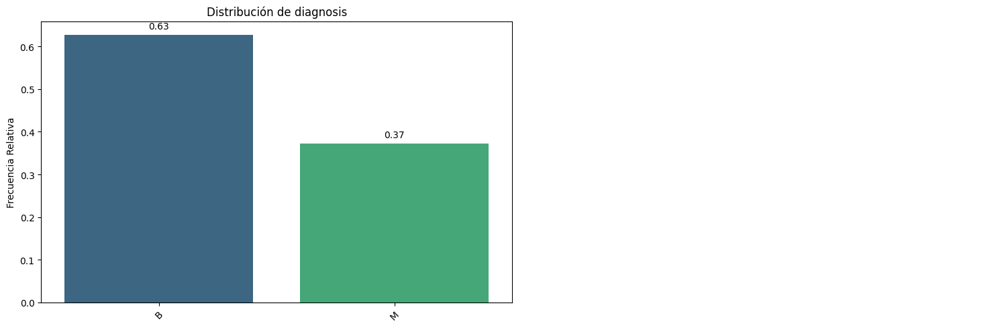

In [98]:
bt.pinta_distribucion_categoricas(df_breast_cancer, [target], mostrar_valores=True,relativa=True)

*Tenemos un "clásico" dataset desequilibrado, pero sin llegar a extremos, un "balanced_accuracy" en estos casos suele ser una buena métrica, si las indicaiones de "Negocio" no nos sugieren otra cosa*

### Ejercicio 4: MiniEDA (I) Análisis Visual

Realiza un análisis visual de las features y haz tu selección de primera "división" (que luego usaremos para comparar con otros métodos de selección).

In [68]:
sns.pairplot(df_breast_cancer,hue=target)

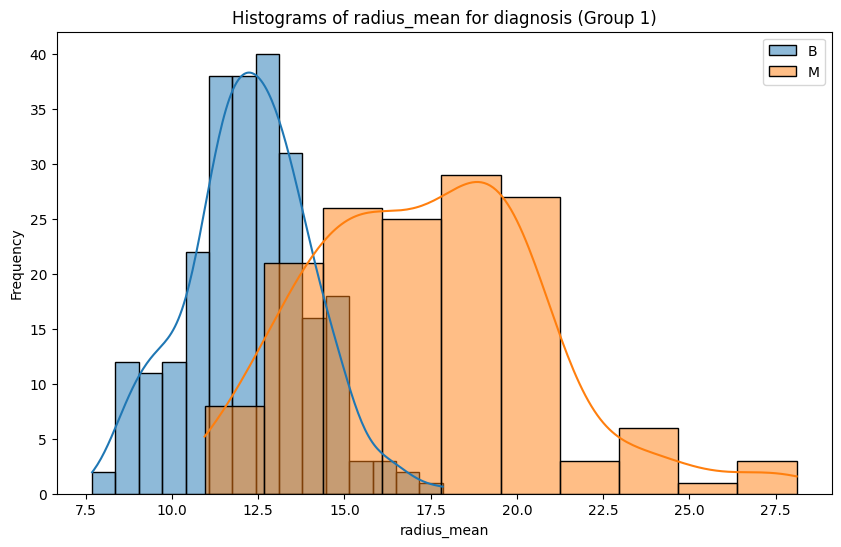

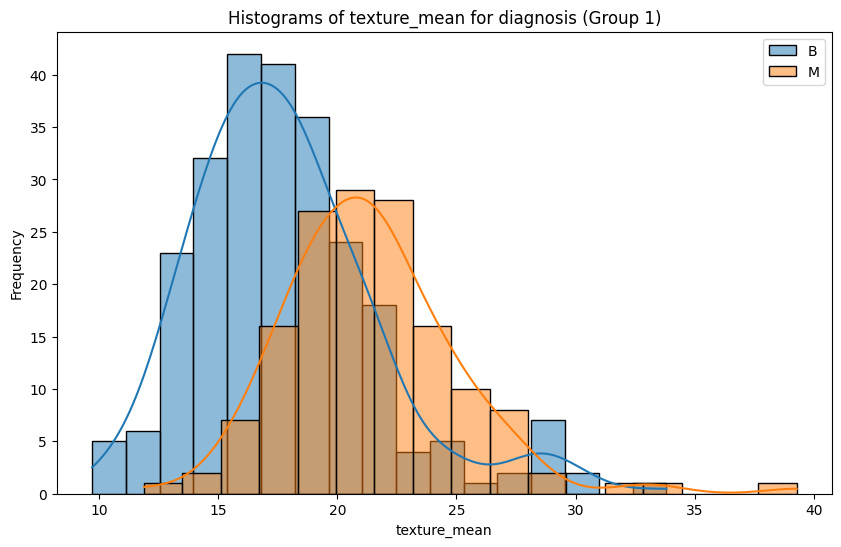

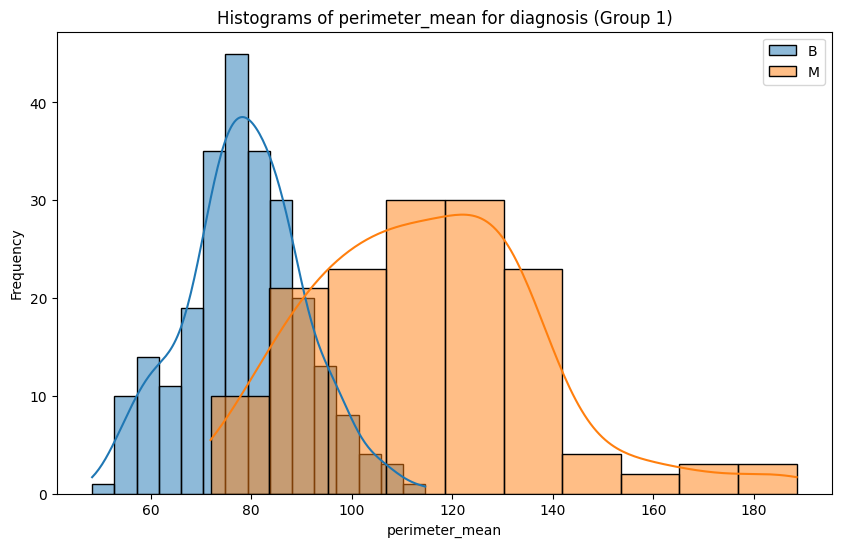

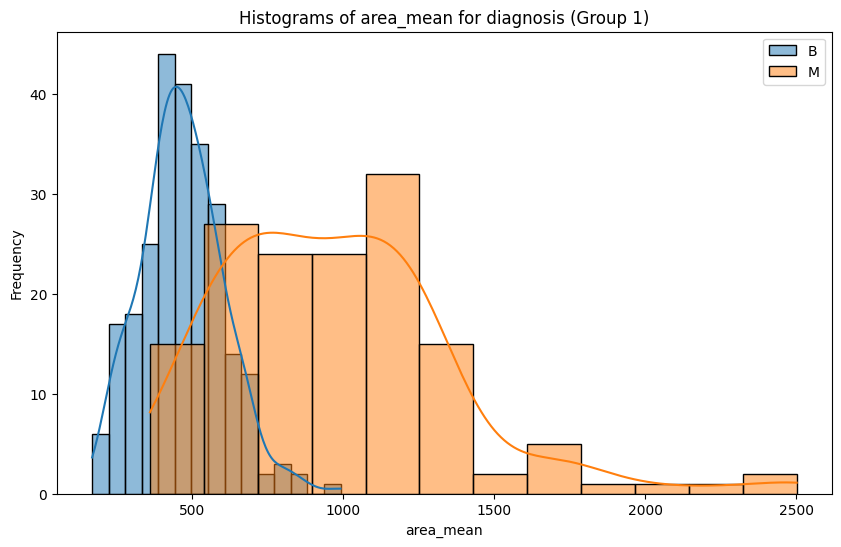

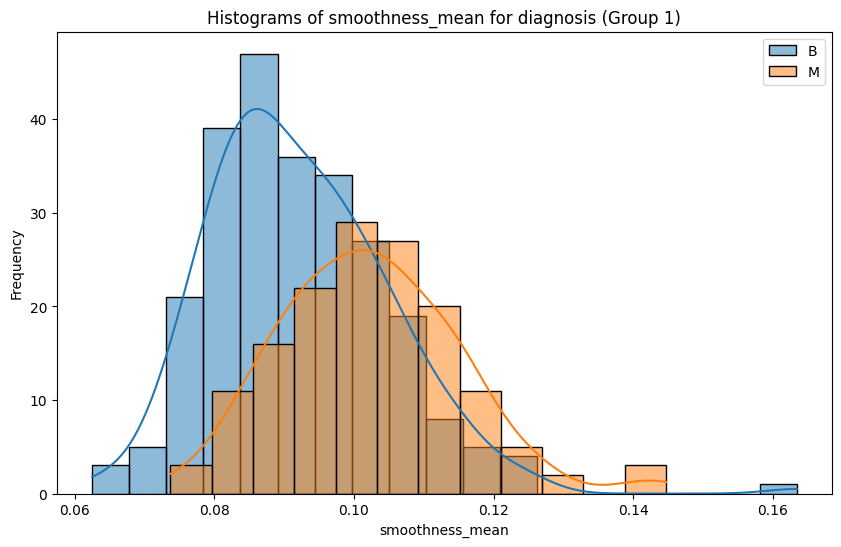

...

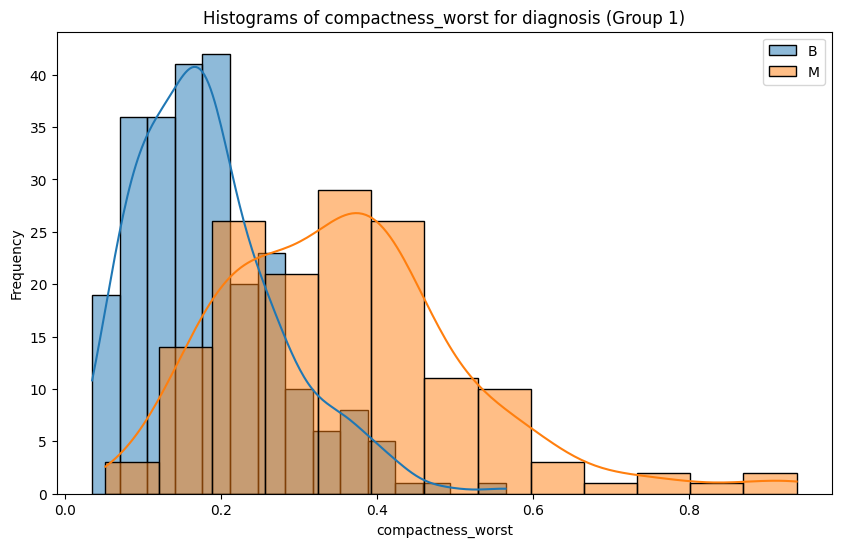

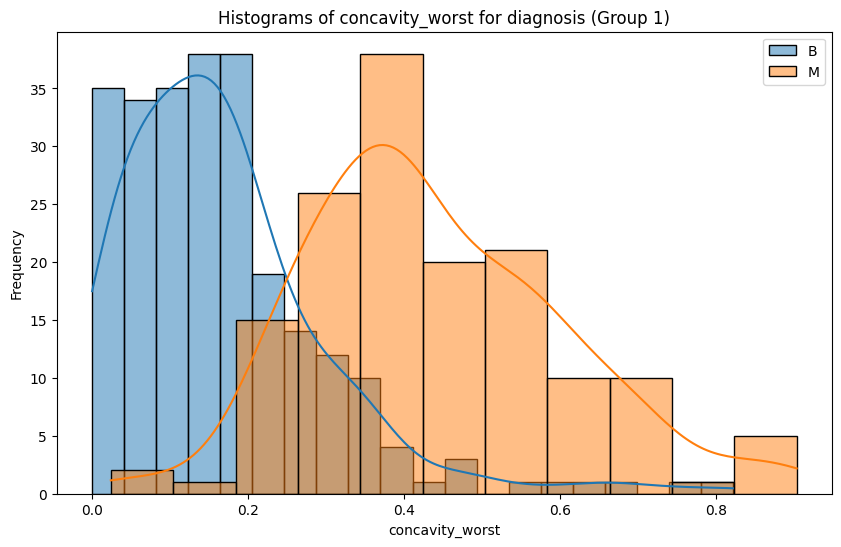

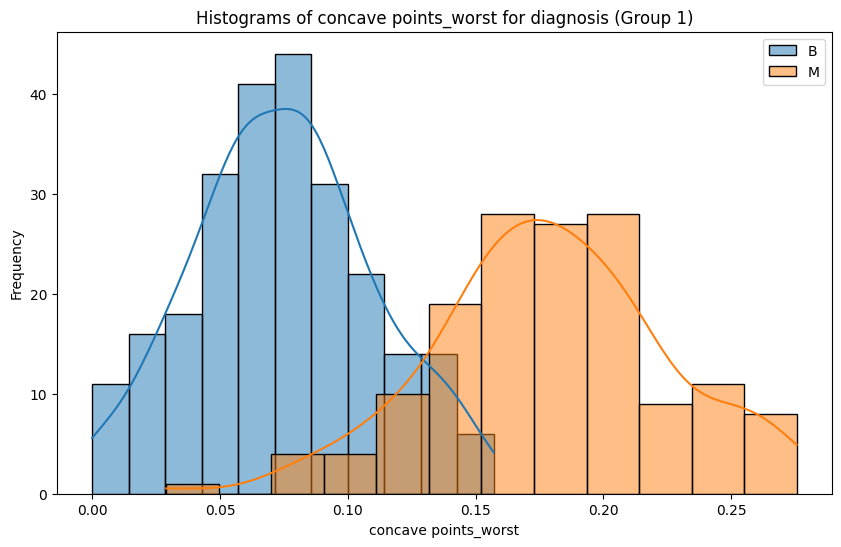

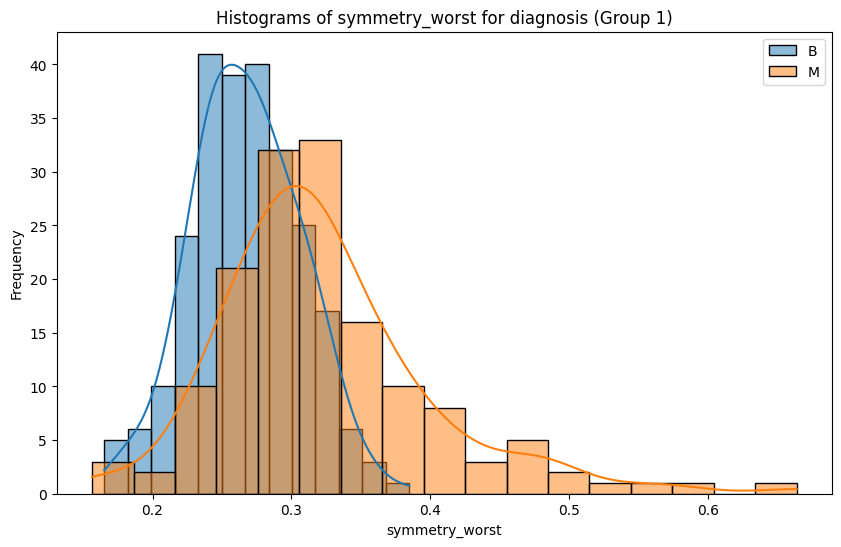

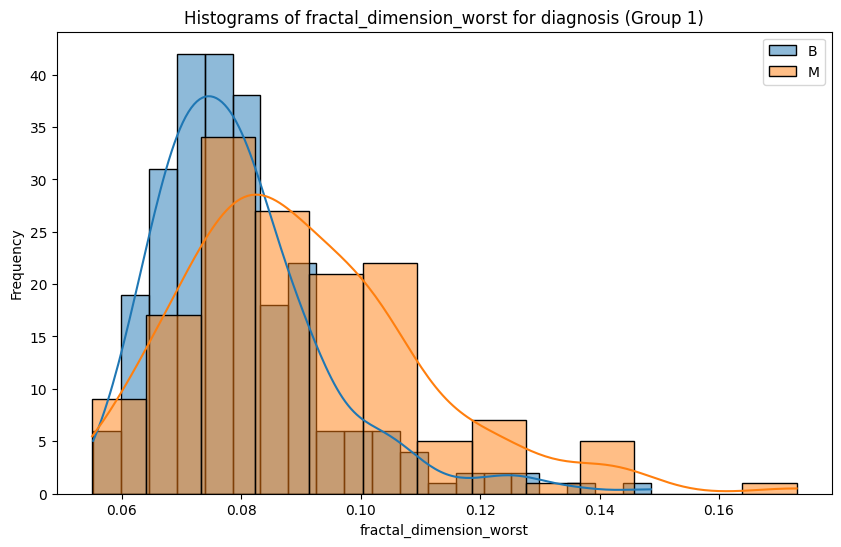

In [69]:
for col in train_set.columns:
    if col != target:
        bt.plot_grouped_histograms(train_set, target, col, group_size = 2)

In [99]:
features_segunda = ["texture_se","smoothness_se","simmetry_se","fractal_dimension_se"]

In [100]:
features_visual = [col for col in train_set.columns if col not in features_segunda]
features_visual.remove(target)

### Ejercicio 5

Observa correlaciones entre las features. Utiliza un gráfico apropiado para ello. ¿Crees que sea posible eliminar algunas features para mejorar el modelo? (No hace falta que lo hagas ahora, lo haremos si es necesario en un ejercicio posterior)

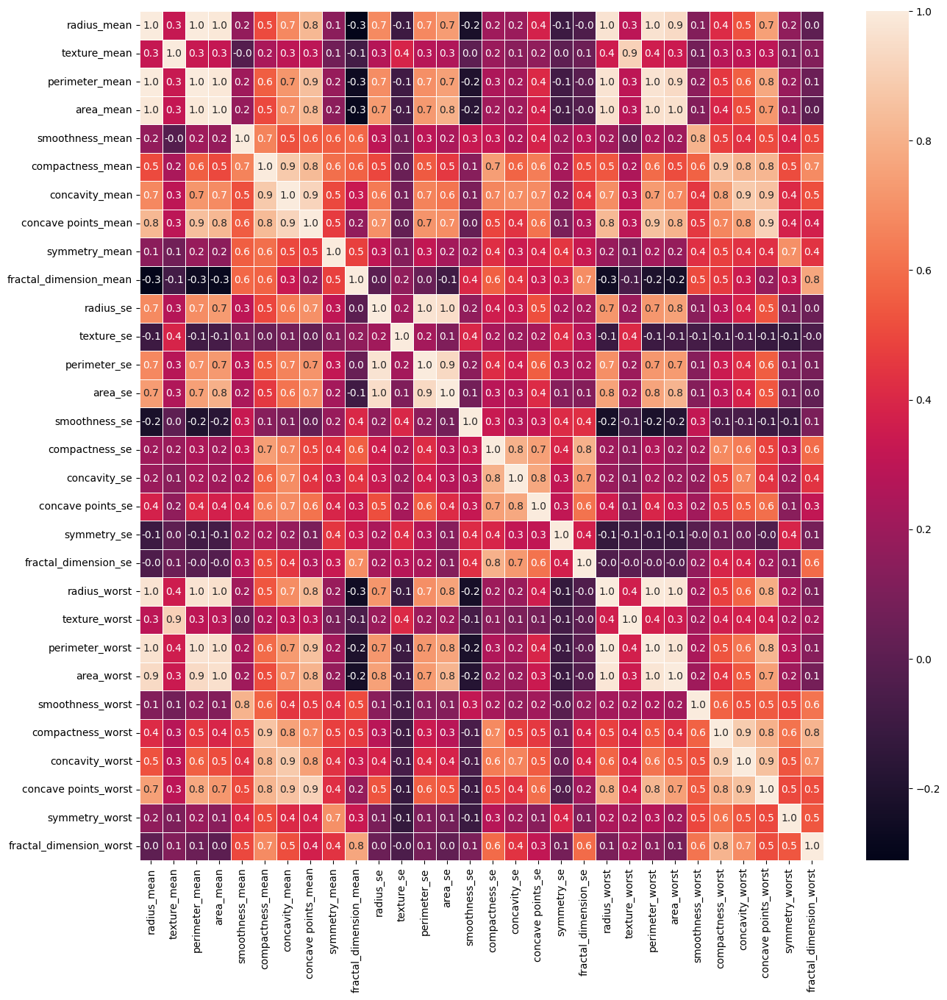

In [77]:
plt.figure(figsize=(15, 15))
sns.heatmap(df_breast_cancer.corr(numeric_only=True), annot=True, linewidths=.5, fmt= '.1f');

### Ejercicio 6:

Entrena (con validación cruzada) un modelo de RandomForestClassifier (con max_depth a 5) con todas las features (ojo incluso las que descartamos en el ejercicio 4) y guarda el perfomance ("balanced_accuracy") en test en una variable. Será nuestro base line de comparación

In [104]:
X_train = train_set.drop("diagnosis", axis=1)
y_train = train_set["diagnosis"]

In [79]:
rfc = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=5)

In [80]:
baseline= np.mean(cross_val_score(rfc, X_train, y_train, cv = 5, scoring = "balanced_accuracy"))
baseline

np.float64(0.9387919305653296)

*Obtuvimos un muy buen balanced_accuracy, sin embargo estamos utilizando 30 features lo cual puede ser complicado a la hora de interpretar o poner en producción, además de consumir mas recursos computacionales. ¿Podemos obtener un valor más o menos similar con menos features? Probemos.*

### Ejercicio 7

Vamos a emplear nuestras features del análisis visual pero descartando variables correladas entre sí (emplea la matriz ya obtenida en el ejercicio 5 o bien cualquier medio que creas conveniente). Descarta features y muestra la matriz de correlación para la selección final (recuerda, parte de la lista creada en el ejercicio 4)

In [81]:
corr=df_breast_cancer[features_visual].corr(numeric_only= True)
corr

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413
fractal_dimension_mean,-0.311631,-0.076437,-0.261477,-0.283110,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,...,-0.253691,-0.051269,-0.205151,-0.231854,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297


Correladas: **radius_mean**, **perimeter_mean**, **area_mean** --> Usamos **area_mean**

Correladas:  **Compactness_mean**, **concavity_mean**,  **concave points_mean** --> Usamos **concavity_mean**

Correladas: **radius_se**, **perimeter_se**, **area_se** --> Usamos **area_se**

Correladas: **radius_worst**, **perimeter_worst**, **area_worst** --> Usamos **area_worst**.

Correladas: **Compactness_worst**, **concavity_worst**,  **concave points_worst** --> Usamos **concavity_worst**

Correladas: **Compactness_se**, **concavity_se**, **concave points_se** --> Usamos **concavity_se**..

Correladas: **area_worst**, **area_mean**, **area_se** --> Usamos **area_mean**.

Correladas: **concacivity_worst**, **concavity_mean** --> Usamos **concavity_worst**

Correladas: **fractal_dimension_mean**, **fractal_dimension_worst** --> Usamos cualquiera: **fractal_dimension_mean**

Correladas: **smoothness_mean**, **smoothness_worst** -->Comparando plot_grouped_histograms: **smoothness_worst**

In [82]:
drop_list = ['perimeter_mean','radius_mean','compactness_mean',
             'concave points_mean','radius_se','perimeter_se',
             'radius_worst','perimeter_worst','compactness_worst',
             'concave points_worst','compactness_se','concave points_se',
             'texture_worst','area_worst', 'area_se', 'concavity_mean',
             'fractal_dimension_mean','smoothness_mean']

features_visual_final  = [col for col in features_visual if col not in drop_list]

In [83]:
features_visual_final

['texture_mean',
 'area_mean',
 'symmetry_mean',
 'concavity_se',
 'symmetry_se',
 'smoothness_worst',
 'concavity_worst',
 'symmetry_worst',
 'fractal_dimension_worst']

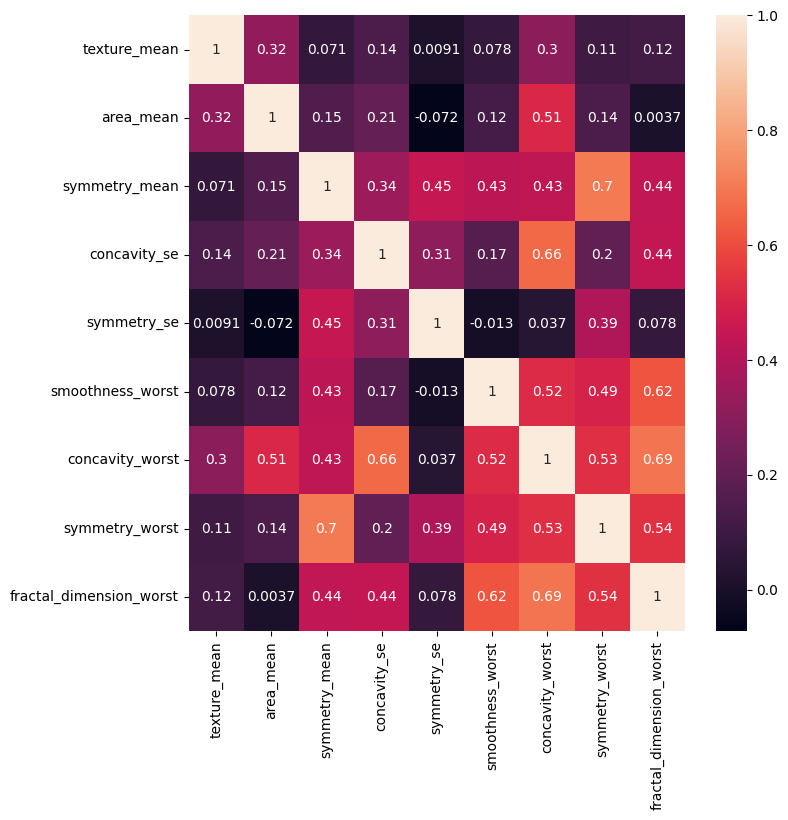

In [84]:
plt.figure(figsize=(8,8))
sns.heatmap(df_breast_cancer[features_visual_final].corr(numeric_only=True), annot= True);

### Ejercicio 8

Evalúa tu primer feature reduction. Entrena un modelo y evalúa su perfomance con los features que seleccionaste en el ejercicio anterios (emplea la validación cruzada)

In [85]:
X_train_visual = X_train[features_visual_final]

In [86]:
rfc = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=5)
model_1= np.mean(cross_val_score(rfc, X_train_visual, y_train, cv = 5, scoring = "balanced_accuracy"))
model_1

np.float64(0.942125263898663)

In [87]:
baseline

np.float64(0.9387919305653296)

### Ejercicio 9

Prueba ahora a hacer una feature selection utilizando ANOVA. Compara la validación cruzada con la del modelo baseline y con la del modelo anterior. (Pista: SelectKbest)

In [105]:
from sklearn.feature_selection import SelectKBest, f_classif
selector = SelectKBest(f_classif, k=5)
x_data_kbest = selector.fit_transform(X_train, y_train)
X_train_kbest = pd.DataFrame(x_data_kbest, columns = selector.get_feature_names_out())
X_train_kbest

,perimeter_mean,concave points_mean,radius_worst,perimeter_worst,concave points_worst
0,88.12,0.01329,15.340,97.19,0.06019
1,86.10,0.02800,14.260,91.99,0.08978
2,98.22,0.06300,16.460,114.10,0.11080
3,82.53,0.02377,13.880,90.81,0.08235
4,87.19,0.02443,15.350,97.58,0.07174
...,...,...,...,...,...
393,58.79,0.02872,9.733,62.56,0.04786
394,75.17,0.03485,13.140,85.51,0.12180
395,90.30,0.00625,14.910,94.44,0.03333
396,91.12,0.06463,17.040,113.90,0.18270


In [106]:
rfc = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=5)
model_2= np.mean(cross_val_score(rfc, X_train_kbest, y_train, cv = 5, scoring = "balanced_accuracy"))
model_2

np.float64(0.9235735397607318)

In [107]:
model_1

np.float64(0.942125263898663)

In [108]:
baseline

np.float64(0.9387919305653296)

### Ejercicio 10

Prueba a hacer ahora una selección de features con RFE (Recursive Feature Elimination), hasta quedarte con 5 features. Evalúa perfomance en "balanced_accuracy" con cross_validation y compara con la baseline.

In [110]:
from sklearn.feature_selection import RFE

In [114]:
rf_RFE = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=5)

# RFE
rfe = RFE(estimator=rf_RFE, n_features_to_select=5, step=1)
rfe.fit(X_train, y_train)

# Crear DataFrame con los rankings
ranking_df = pd.DataFrame({
    "feature": X_train.columns,
    "ranking": rfe.ranking_
}).sort_values("ranking")

print(ranking_df)

                    feature  ranking
7       concave points_mean        1
20             radius_worst        1
23               area_worst        1
22          perimeter_worst        1
27     concave points_worst        1
6            concavity_mean        2
3                 area_mean        3
21            texture_worst        4
26          concavity_worst        5
13                  area_se        6
2            perimeter_mean        7
1              texture_mean        8
0               radius_mean        9
28           symmetry_worst       10
25        compactness_worst       11
24         smoothness_worst       12
10                radius_se       13
19     fractal_dimension_se       14
5          compactness_mean       15
12             perimeter_se       16
29  fractal_dimension_worst       17
16             concavity_se       18
11               texture_se       19
17        concave points_se       20
15           compactness_se       21
18              symmetry_se       22
1

In [116]:
X_train_rfe = rfe.transform(X_train)

In [117]:
rfe_score = np.mean(cross_val_score(rfe, X_train_rfe, y_train, cv = 5, scoring= "balanced_accuracy"))
rfe_score

np.float64(0.9242402064273986)

In [118]:
features_rfe = rfe.get_feature_names_out()
features_rfe

array(['concave points_mean', 'radius_worst', 'perimeter_worst',
       'area_worst', 'concave points_worst'], dtype=object)

In [119]:
baseline

np.float64(0.9387919305653296)

### Ejercicio 11

Prueba a eliminar features con el modelo de RandomForestClassifier (emplea SelectFromModel de sklearn). Utiliza esta vez una regresión logística para entrenar con las features escogidas y compara con el baseline. Muestra primero la importancia obtenida con el modelo baseline (que básicamente es el mismo que vamos a usar con SelectFromModel). Prueba primero para features por encima de la mediana y luego para las 5 primeras.

In [132]:
from sklearn.feature_selection import SelectFromModel
selector_model = SelectFromModel(estimator = rfc, threshold= "median")

In [133]:
selector_model.fit(X_train,y_train)

SelectFromModel(estimator=RandomForestClassifier(max_depth=5, random_state=42),
                threshold='median')

In [134]:
selector_model.get_feature_names_out()

array(['radius_mean', 'perimeter_mean', 'area_mean', 'concavity_mean',
       'concave points_mean', 'radius_se', 'perimeter_se', 'area_se',
       'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst'],
      dtype=object)

In [135]:
from sklearn.linear_model import LogisticRegression

lc_clf = LogisticRegression(max_iter = 1000)
X_train_model_median = selector_model.transform(X_train)
score_model_median = np.mean(cross_val_score(lc_clf, X_train_model_median, y_train, cv = 5, scoring = "balanced_accuracy"))
score_model_median

np.float64(0.936751114238799)

In [136]:
baseline

np.float64(0.9387919305653296)

In [137]:
selector_model = SelectFromModel(estimator = rfc, threshold= "median", max_features= 5) 
selector_model.fit(X_train,y_train)
print("Escogidas:", selector_model.get_feature_names_out())

lc_clf = LogisticRegression(max_iter = 1000)
X_train_model_median = selector_model.transform(X_train)
score_model_median = np.mean(cross_val_score(lc_clf, X_train_model_median, y_train, cv = 5, scoring = "balanced_accuracy"))
score_model_median

Escogidas: ['concavity_mean' 'concave points_mean' 'radius_worst' 'area_worst'
 'concave points_worst']


np.float64(0.8863654703260615)

### Ejercicio EXTRA:

Investiga RFECV y obten el número optimo de features siguiendo esta técnica pero con el "balanced_accuracy" como métrica.

In [138]:
#Rfe con cross validation
from sklearn.feature_selection import RFECV

rfc_4 = RandomForestClassifier() 
rfecv = RFECV(estimator=rfc_4, step=1, cv=5,scoring='balanced_accuracy')
rfecv = rfecv.fit(X_train, y_train)

print('Optimal number of features :', rfecv.n_features_)
print('Best features :', list(X_train.columns[rfecv.support_]))
print("Best features (alternative):", rfecv.get_feature_names_out())
print('Accuracy feat. reduction 4:', np.mean(cross_val_score(rfc_4, X_train[rfecv.get_feature_names_out()],y_train, cv = 5, scoring = "balanced_accuracy")))

Optimal number of features : 14
Best features : ['texture_mean', 'perimeter_mean', 'area_mean', 'concavity_mean', 'concave points_mean', 'radius_se', 'area_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst']
Best features (alternative): ['texture_mean' 'perimeter_mean' 'area_mean' 'concavity_mean'
 'concave points_mean' 'radius_se' 'area_se' 'radius_worst'
 'texture_worst' 'perimeter_worst' 'area_worst' 'compactness_worst'
 'concavity_worst' 'concave points_worst']
Accuracy feat. reduction 4: 0.963021815622801
